# **Import Libraries**

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder, StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from imblearn.over_sampling import SMOTE



In [ ]:
# Load dataset
df = pd.read_csv('city_day.csv')

In [ ]:
!pip install lime


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 8.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=f31ecca868c05f98608fa3a86b6610669ad8fef4d3d61f6841ee9f3b5ef0959d
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


# **Visualize the Dataset**

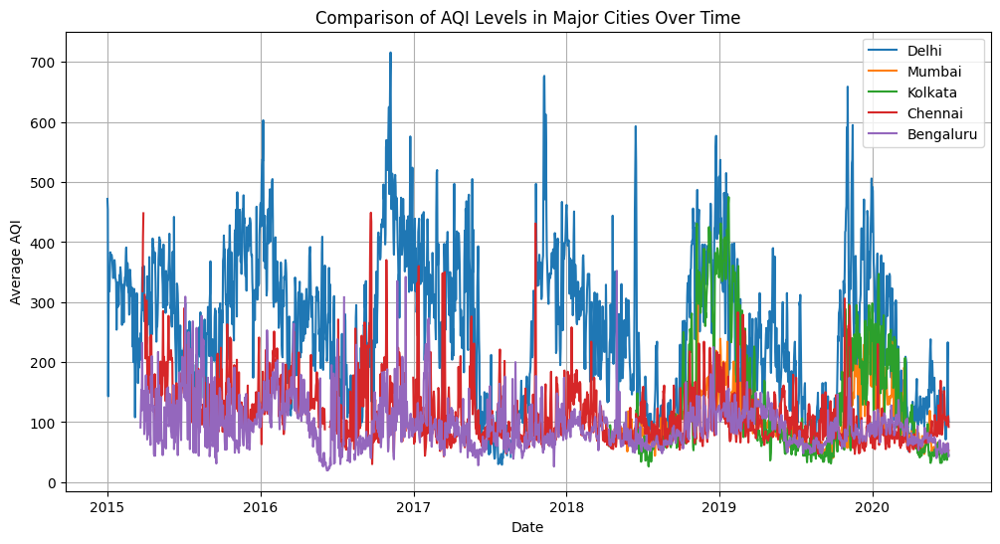

In [ ]:

# Convert Date column to datetime format
df["Date"] = pd.to_datetime(df["Date"])

# Select a few major cities for comparison
selected_cities = ["Delhi", "Mumbai", "Kolkata", "Chennai", "Bengaluru"]
df_filtered = df[df["City"].isin(selected_cities)]

# Group by Date and City, taking the mean AQI values
df_grouped = df_filtered.groupby(["Date", "City"])["AQI"].mean().unstack()

# Plot the AQI trends
plt.figure(figsize=(12, 6))
for city in selected_cities:
    plt.plot(df_grouped.index, df_grouped[city], label=city)

plt.xlabel("Date")
plt.ylabel("Average AQI")
plt.title("Comparison of AQI Levels in Major Cities Over Time")
plt.legend()
plt.grid(True)
plt.show()


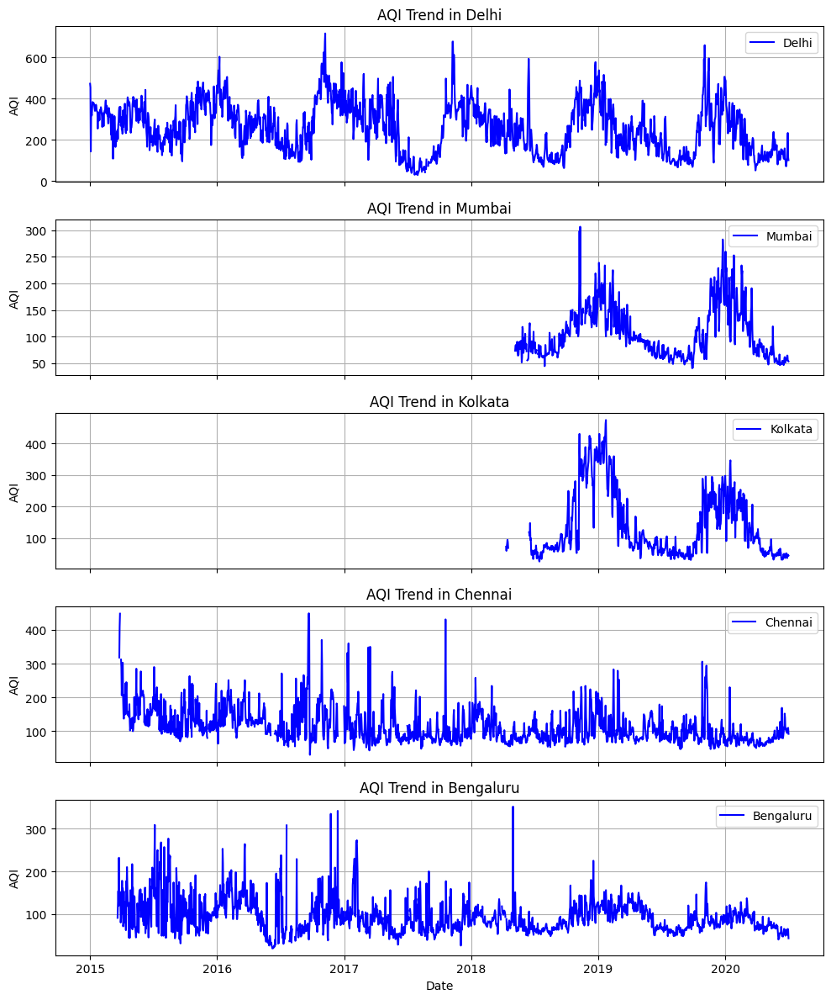

In [ ]:
df["Date"] = pd.to_datetime(df["Date"])

# Select a few major cities for comparison
selected_cities = ["Delhi", "Mumbai", "Kolkata", "Chennai", "Bengaluru"]
df_filtered = df[df["City"].isin(selected_cities)]

# Group by Date and City, taking the mean AQI values
df_grouped = df_filtered.groupby(["Date", "City"])["AQI"].mean().unstack()

# Create subplots
fig, axes = plt.subplots(len(selected_cities), 1, figsize=(10, 12), sharex=True)

for i, city in enumerate(selected_cities):
    axes[i].plot(df_grouped.index, df_grouped[city], label=city, color="b")
    axes[i].set_title(f"AQI Trend in {city}")
    axes[i].set_ylabel("AQI")
    axes[i].legend()
    axes[i].grid(True)

plt.xlabel("Date")
plt.tight_layout()
plt.show()

In [ ]:
# prompt: size of df

df.shape


(29531, 16)

In [ ]:
df.head()


,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
1,Ahmedabad,2015-01-02,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2,Ahmedabad,2015-01-03,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
3,Ahmedabad,2015-01-04,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
4,Ahmedabad,2015-01-05,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN


In [ ]:
# Drop unnecessary columns
df.drop(['Benzene', 'Toluene', 'Xylene', 'NH3', 'Date'], axis=1, inplace=True)

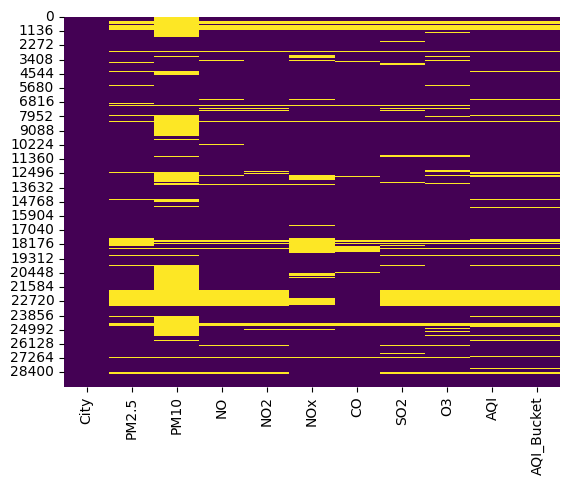

In [ ]:
# Visualize missing values
sns.heatmap(df.isnull(), cbar=False, cmap='viridis')
plt.show()

# **Handle Missing Values**

In [ ]:
# Handle missing values
for col in ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'CO', 'SO2', 'O3', 'AQI']:
    df[col].fillna(df[col].mean(), inplace=True)

df['City'].fillna(df['City'].mode()[0], inplace=True)
df['AQI_Bucket'].fillna(df['AQI_Bucket'].mode()[0], inplace=True)

<ipython-input-10-2cd7f97c9f01>:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(df[col].mean(), inplace=True)
<ipython-input-10-2cd7f97c9f01>:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'd

# **Encoding and Removing Outlier**

<ipython-input-11-6b658c3ce92d>:15: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(df[col].mean(), inplace=True)
<ipython-input-11-6b658c3ce92d>:16: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 

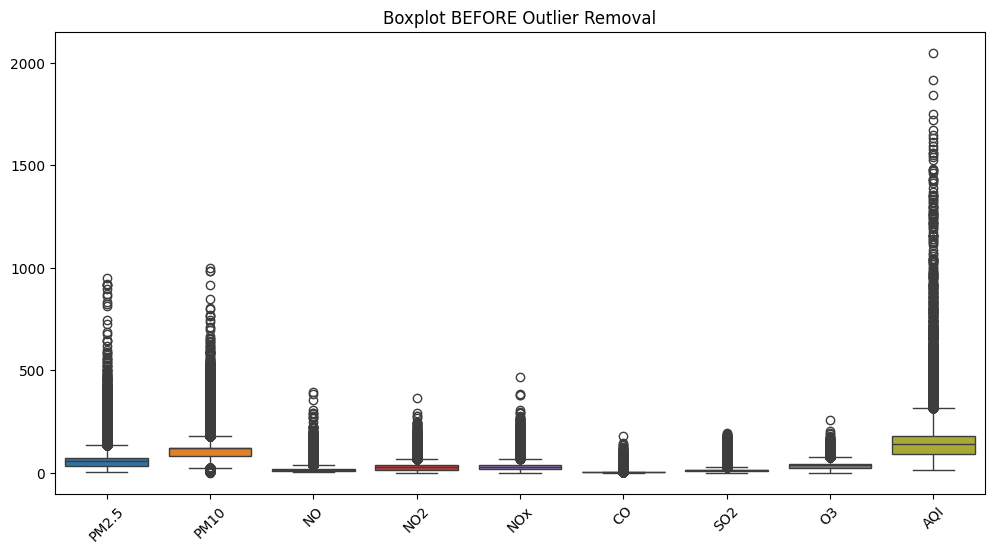

Original dataset size: 29531
Target dataset size (80%): 23625
Threshold: 1.50, Remaining data size: 19199 (65.01%)
Threshold: 1.60, Remaining data size: 19751 (66.88%)
Threshold: 1.70, Remaining data size: 20226 (68.49%)
Threshold: 1.80, Remaining data size: 20632 (69.87%)
Threshold: 1.90, Remaining data size: 20983 (71.05%)
Threshold: 2.00, Remaining data size: 21301 (72.13%)
Threshold: 2.10, Remaining data size: 21611 (73.18%)
Threshold: 2.20, Remaining data size: 21847 (73.98%)
Threshold: 2.30, Remaining data size: 22083 (74.78%)
Threshold: 2.40, Remaining data size: 22302 (75.52%)
Threshold: 2.50, Remaining data size: 22533 (76.30%)
Threshold: 2.60, Remaining data size: 22732 (76.98%)
Threshold: 2.70, Remaining data size: 22913 (77.59%)
Threshold: 2.80, Remaining data size: 23107 (78.25%)
Threshold: 2.90, Remaining data size: 23296 (78.89%)
Threshold: 3.00, Remaining data size: 23480 (79.51%)
Threshold: 3.10, Remaining data size: 23675 (80.17%)
Outliers removed successfully with th

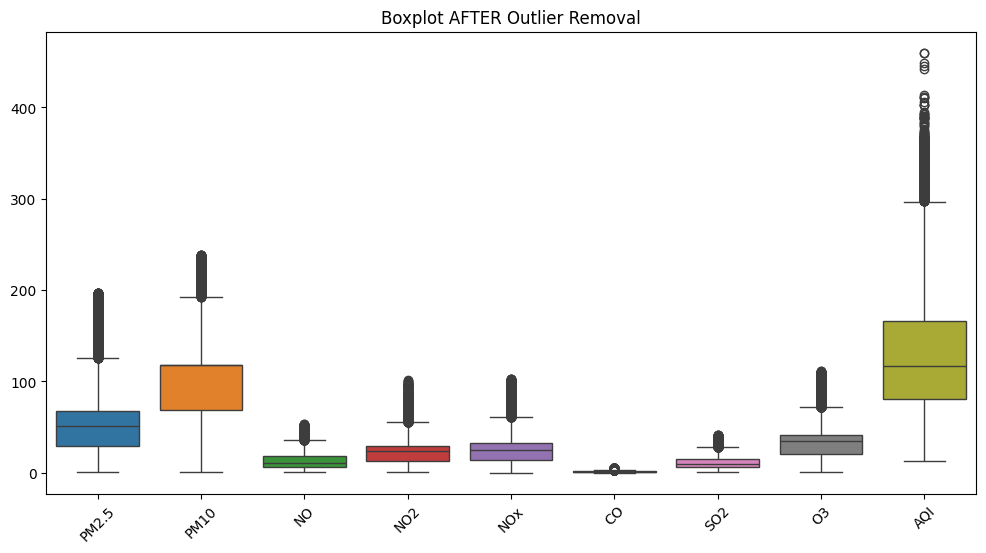

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder

# Load the dataset
df = pd.read_csv('city_day.csv')  # Ensure this file is in your working directory

# Drop unnecessary columns
df.drop(['Benzene', 'Toluene', 'Xylene', 'NH3', 'Date'], axis=1, inplace=True)

# Handle missing values
for col in ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'CO', 'SO2', 'O3', 'AQI']:
    df[col].fillna(df[col].mean(), inplace=True)
df['City'].fillna(df['City'].mode()[0], inplace=True)
df['AQI_Bucket'].fillna(df['AQI_Bucket'].mode()[0], inplace=True)

# Encoding AQI_Bucket
oe = OrdinalEncoder(categories=[['Moderate', 'Satisfactory', 'Poor', 'Very Poor', 'Good', 'Severe']])
df['AQI_Bucket_Encoded'] = oe.fit_transform(df[['AQI_Bucket']])
df.drop('AQI_Bucket', axis=1, inplace=True)

# One-hot encoding for 'City'
ohe = OneHotEncoder(sparse_output=False)
city_encoded = ohe.fit_transform(df[['City']])
city_encoded_df = pd.DataFrame(city_encoded, columns=ohe.get_feature_names_out(['City']))
df = pd.concat([df, city_encoded_df], axis=1)
df.drop('City', axis=1, inplace=True)

# Define numerical columns
numerical_cols = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'CO', 'SO2', 'O3', 'AQI']
available_cols = [col for col in numerical_cols if col in df.columns]

# Visualize data BEFORE outlier removal
plt.figure(figsize=(12, 6))
sns.boxplot(data=df[available_cols])
plt.title("Boxplot BEFORE Outlier Removal")
plt.xticks(rotation=45)
plt.show()

# Outlier Detection with Adjusted Threshold
Q1 = df[available_cols].quantile(0.25)
Q3 = df[available_cols].quantile(0.75)
IQR = Q3 - Q1
original_size = df.shape[0]
target_size = original_size * 0.80  # Target 80% of original size

print(f"Original dataset size: {original_size}")
print(f"Target dataset size (80%): {target_size:.0f}")

threshold = 1.5  # Start with a baseline
step = 0.1  # Increment to fine-tune
max_threshold = 5.0  # Upper limit to avoid infinite loop

while threshold <= max_threshold:
    filtered_df = df[~((df[available_cols] < (Q1 - threshold * IQR)) |
                       (df[available_cols] > (Q3 + threshold * IQR))).any(axis=1)]
    remaining_size = filtered_df.shape[0]
    percentage = remaining_size / original_size * 100
    print(f"Threshold: {threshold:.2f}, Remaining data size: {remaining_size} ({percentage:.2f}%)")

    if remaining_size >= target_size:  # Stop when we retain at least 80%
        df = filtered_df
        print(f"Outliers removed successfully with threshold {threshold:.2f}")
        break
    threshold += step  # Increase threshold to retain more data

# Check final size
if df.shape[0] == 0:
    print("Warning: No data left after outlier removal. Consider adjusting logic.")
elif df.shape[0] < target_size:
    print(f"Note: Could not retain 80%. Final size: {df.shape[0]} ({df.shape[0]/original_size*100:.2f}%)")
else:
    print(f"Dataset size after outlier removal: {df.shape[0]} ({df.shape[0]/original_size*100:.2f}%)")

# Visualize data AFTER outlier removal
plt.figure(figsize=(12, 6))
sns.boxplot(data=df[available_cols])
plt.title("Boxplot AFTER Outlier Removal")
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Splitting Features and Target
X = df.drop('AQI_Bucket_Encoded', axis=1)
y = df['AQI_Bucket_Encoded']

In [ ]:
# Ensure there are enough samples before train-test split
if X.shape[0] < 2:
    raise ValueError("Not enough samples to perform train-test split.")

# Compute correlation matrix and drop highly correlated features
corr_matrix = X.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
to_drop = [column for column in upper.columns if any(upper[column] > 0.85)]
X.drop(columns=to_drop, inplace=True)

# Train-test split with a check to avoid empty train set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
if X_train.shape[0] == 0 or X_test.shape[0] == 0:
    raise ValueError("Train-test split resulted in an empty dataset. Adjust test_size or check data preprocessing.")


In [ ]:
# SMOTE for balancing classes
if len(np.unique(y_train)) > 1:
    smote = SMOTE(random_state=42)
    X_resampled_smote, y_resampled_smote = smote.fit_resample(X_train, y_train)
else:
    X_resampled_smote, y_resampled_smote = X_train, y_train

In [ ]:
# Feature Scaling
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_resampled_smote)
X_test_scaled = scaler.transform(X_test)

# **Random Forest**

In [ ]:
# Regularized Random Forest Classifier
rf = RandomForestClassifier(
    n_estimators=100,
    random_state=42,
    max_depth=10,
    min_samples_split=10,
    min_samples_leaf=5,
    max_features='sqrt',
    n_jobs=-1
)
rf.fit(X_train_scaled, y_resampled_smote)
y_pred_rf = rf.predict(X_test_scaled)
print(f'Random Forest Accuracy: {accuracy_score(y_test, y_pred_rf):.4f}')

Random Forest Accuracy: 0.7734


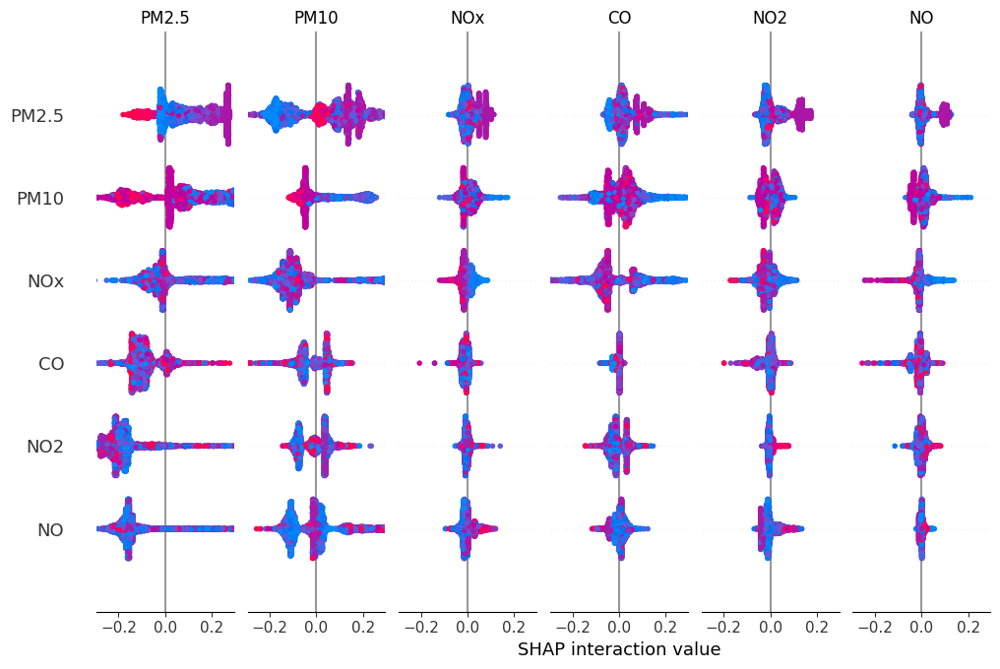

In [ ]:
import shap
import matplotlib.pyplot as plt
import pandas as pd

# Ensure X_test_scaled is a DataFrame with feature names
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

# Initialize SHAP explainer
explainer = shap.TreeExplainer(rf)

# Compute SHAP values
shap_values = explainer.shap_values(X_test_scaled)

# Ensure correct SHAP values format for classification
if isinstance(shap_values, list) and len(shap_values) == 2:
    shap_values = shap_values[1] - shap_values[0]  # Binary classification fix

# Plot SHAP summary (global feature importance)
shap.summary_plot(shap_values, X_test_scaled)


In [ ]:
import numpy as np
from lime.lime_tabular import LimeTabularExplainer
import pandas as pd

# Ensure X_train_scaled and X_test_scaled are DataFrames with column names
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

# Initialize LIME explainer with correct feature names
explainer = LimeTabularExplainer(
    training_data=X_train_scaled.values,  # Convert DataFrame to NumPy array
    feature_names=X_train_scaled.columns.tolist(),  # Use actual feature names
    class_names=['Class 0', 'Class 1'],
    mode='classification'
)

# Explain a single prediction (first test sample)
idx = 0
exp = explainer.explain_instance(
    X_test_scaled.iloc[idx].values,  # Convert row to NumPy array
    rf.predict_proba
)

# Show explanation
exp.show_in_notebook()

# Print text explanation with proper labels
print(exp.as_list())


[('PM2.5 <= -0.95', 0.12204380993689296), ('-0.70 < PM10 <= 0.25', -0.033730980239209854), ('City_Ernakulam <= -0.05', 0.025634259678243572), ('City_Kochi <= -0.03', 0.022722415554847095), ('City_Shillong <= -0.14', -0.02127605514462618), ('SO2 > 0.55', -0.013379695936782439), ('City_Ahmedabad <= -0.12', -0.009969254177452641), ('City_Guwahati <= -0.17', 0.009820178154155517), ('City_Aizawl <= -0.11', 0.009126125745860155), ('City_Brajrajnagar <= -0.19', 0.008183843379596994)]


# **SVM**

In [ ]:
# Regularized SVM Classifier with probability enabled
svm = SVC(kernel='rbf', gamma='scale', C=1, random_state=42, probability=True)  # Add probability=True
svm.fit(X_train_scaled, y_resampled_smote)

y_pred_svm = svm.predict(X_test_scaled)
print(f'SVM Accuracy: {accuracy_score(y_test, y_pred_svm):.4f}')


SVM Accuracy: 0.7897


In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Initialize LIME explainer
explainer = LimeTabularExplainer(
    training_data=X_train_scaled,
    feature_names=[f'Feature {i}' for i in range(X_train_scaled.shape[1])],
    class_names=['Class 0', 'Class 1'],
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(X_test_scaled[idx], svm.predict_proba)

# Show explanation
exp.show_in_notebook()

# Print feature contributions
print(exp.as_list())


[('Feature 0 <= -0.95', 0.43715902499159637), ('Feature 19 <= -0.05', -0.27708641555010366), ('Feature 25 <= -0.03', 0.12788058891202972), ('Feature 31 <= -0.12', 0.09852484668039371), ('Feature 23 <= -0.16', -0.08947504404258293), ('Feature 17 <= -0.11', -0.08937934361028305), ('Feature 30 <= -0.14', 0.07700992109700498), ('Feature 9 <= -0.11', 0.0659779867422353), ('Feature 24 <= -0.13', 0.06589108424055522), ('Feature 21 <= -0.17', 0.0475044227689612)]


# **Logistic Regression**

In [ ]:
from sklearn.model_selection import GridSearchCV

# Regularized Logistic Regression
lr = LogisticRegression(max_iter=1000, penalty='l2', solver='lbfgs')
lr.fit(X_train_scaled, y_resampled_smote)
y_pred_lr = lr.predict(X_test_scaled)
print(f'Logistic Regression Accuracy: {accuracy_score(y_test, y_pred_lr):.4f}')

Logistic Regression Accuracy: 0.7001


      PM2.5      PM10        NO       NO2       NOx        CO       SO2  \
0  4.309000 -0.321408  0.051084 -0.245125 -0.029013  0.089749  0.006141   
1  4.063790  0.702235  0.009917  0.040266 -0.037579 -0.058233 -0.002060   
2  0.669176 -1.030550 -0.252627  0.772438  0.415882 -0.354197  0.004433   
3  3.246426 -0.321408 -0.074315  0.181842  0.056943 -0.699489 -0.006832   
4  2.935658 -0.321408  0.125232 -0.501433 -0.225402  0.706340 -0.009322   

         O3  City_Ahmedabad  City_Aizawl  ...    City_Kochi  City_Kolkata  \
0  0.157829       -0.086176    -0.001513  ... -4.939703e-18     -0.036169   
1  0.004849       -0.086176    -0.001513  ... -4.939703e-18     -0.036169   
2 -0.143166       -0.086176    -0.001513  ... -4.939703e-18     -0.036169   
3  0.282881       -0.086176    -0.001513  ... -4.939703e-18     -0.036169   
4 -0.075209       -0.086176    -0.001513  ... -4.939703e-18     -0.036169   

   City_Lucknow  City_Mumbai  City_Patna  City_Shillong  City_Talcher  \
0      0.2567

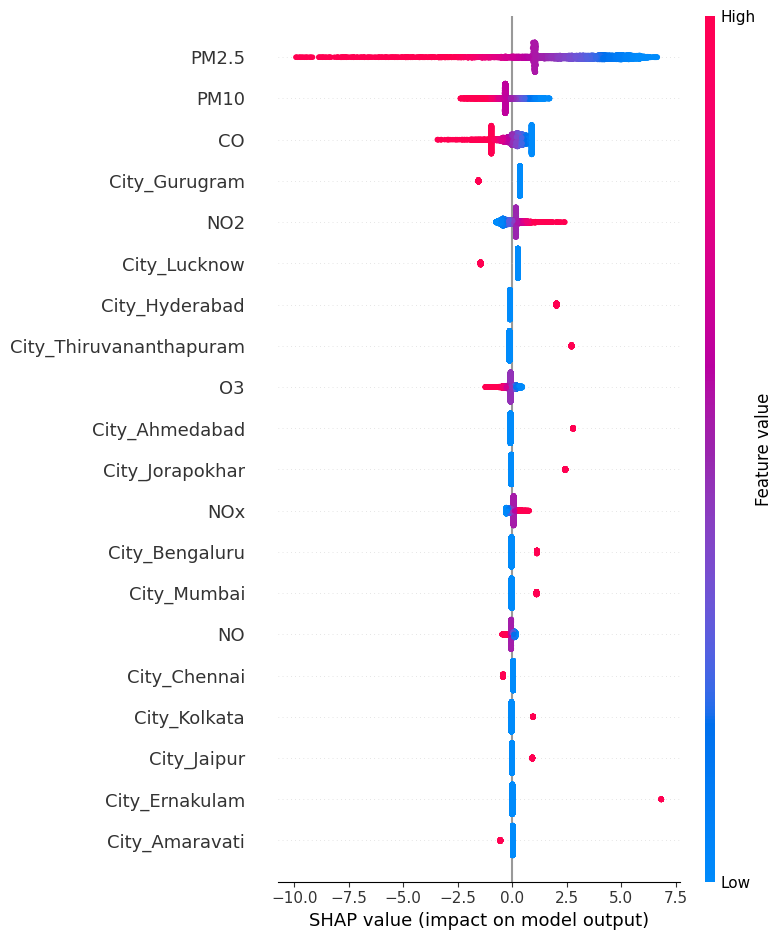

<Figure size 1200x400 with 0 Axes>

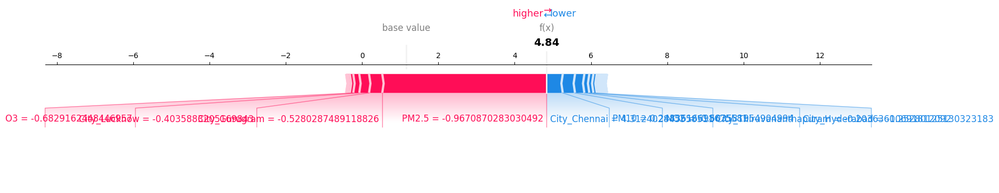

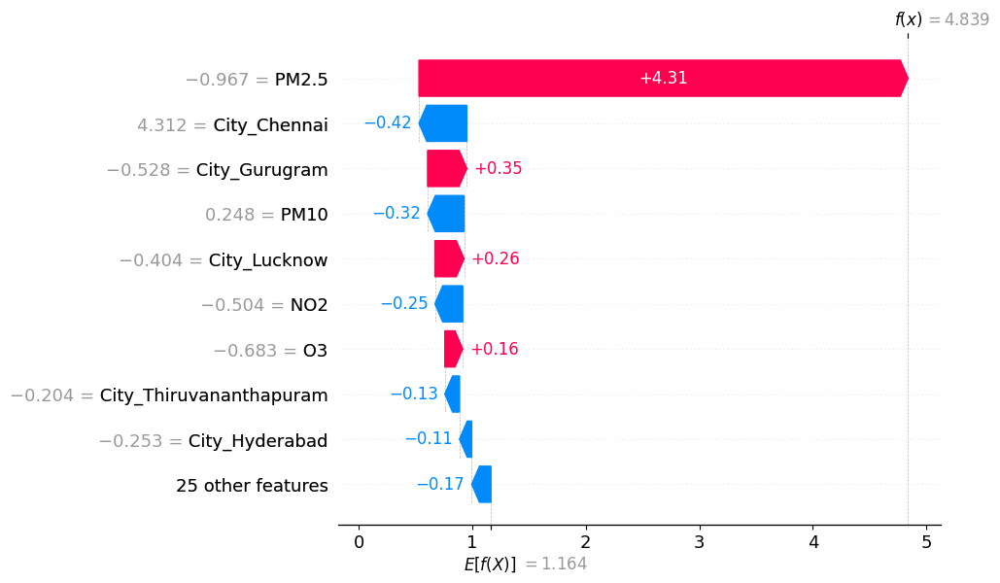

In [ ]:
import shap
import pandas as pd
import matplotlib.pyplot as plt

# Compute SHAP values
explainer = shap.Explainer(lr, X_train_scaled)
shap_values = explainer(X_test_scaled)

# If multi-class, select SHAP values for a specific class (e.g., class 1)
shap_values_selected = shap_values[:, :, 1] if len(shap_values.values.shape) == 3 else shap_values

# Convert SHAP values into a DataFrame with feature names
shap_df = pd.DataFrame(shap_values_selected.values, columns=X_train_scaled.columns)
shap_df['Prediction'] = y_pred_lr  # Add predicted labels for reference

# Print SHAP values
print(shap_df.head())

# SHAP Summary Plot (Feature Importance)
shap.summary_plot(shap_values_selected, X_test_scaled, feature_names=X_train_scaled.columns)

# Fix 1: Increase Plot Width (Prevents Overlapping in Force Plot)
shap.initjs()
plt.figure(figsize=(12, 4))  # Adjust width
shap.force_plot(explainer.expected_value[1], shap_values_selected[0].values, X_test_scaled.iloc[0, :], matplotlib=True)
plt.show()

# Fix 2: Use Waterfall Plot (Better for Individual Predictions)
shap.plots.waterfall(shap_values_selected[0])


In [ ]:
import numpy as np
import pandas as pd
from lime.lime_tabular import LimeTabularExplainer

# Convert NumPy arrays to DataFrames to retain feature names
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

# Initialize LIME explainer with correct feature names
explainer = LimeTabularExplainer(
    training_data=X_train_scaled.values,  # Convert DataFrame to NumPy array
    feature_names=X_train_scaled.columns.tolist(),  # Use actual feature names
    class_names=['Class 0', 'Class 1'],
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(
    X_test_scaled.iloc[idx].values,  # Convert single row to NumPy array
    lr.predict_proba
)

# Show explanation with proper labels
exp.show_in_notebook()

# Print feature contributions with labeled names
print(exp.as_list())


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


[('PM2.5 <= -0.95', 0.4796780485011614), ('City_Ernakulam <= -0.05', 0.11955294235118222), ('City_Brajrajnagar <= -0.19', 0.09390745806139154), ('City_Shillong <= -0.14', 0.09173247644905813), ('City_Kochi <= -0.03', -0.08080150404465435), ('City_Talcher <= -0.12', 0.07451088972470864), ('City_Delhi <= -0.24', 0.07392595261388447), ('City_Thiruvananthapuram <= -0.20', -0.07057217350871899), ('City_Ahmedabad <= -0.12', 0.055809207312731354), ('City_Aizawl <= -0.11', 0.05055695367706366)]


# **KNN**

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train_scaled, y_resampled_smote)
y_pred_knn = knn.predict(X_test_scaled)
print(f'KNN Accuracy: {accuracy_score(y_test, y_pred_knn):.4f}')

KNN Accuracy: 0.7700


In [ ]:
import numpy as np
import pandas as pd
from lime.lime_tabular import LimeTabularExplainer

# Convert NumPy arrays to DataFrames to retain feature names
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

# Initialize LIME explainer with correct feature names
explainer = LimeTabularExplainer(
    training_data=X_train_scaled.values,  # Convert DataFrame to NumPy array
    feature_names=X_train_scaled.columns.tolist(),  # Use actual feature names
    class_names=['Class 0', 'Class 1'],
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(
    X_test_scaled.iloc[idx].values,  # Convert single row to NumPy array
    knn.predict_proba
)

# Show explanation with proper labels
exp.show_in_notebook()

# Print feature contributions with labeled names
print(exp.as_list())


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(


[('City_Ernakulam <= -0.05', -0.5350207456889999), ('City_Kochi <= -0.03', -0.3310366737636246), ('City_Coimbatore <= -0.11', -0.30545585817562937), ('City_Mumbai <= -0.19', -0.2571862463233746), ('City_Jaipur <= -0.16', -0.2164626906556894), ('PM2.5 <= -0.95', 0.19844436360577647), ('City_Bengaluru <= -0.22', -0.1917079896312752), ('City_Amaravati <= -0.21', -0.13824779540536947), ('City_Chandigarh <= -0.12', -0.12297327244247738), ('City_Visakhapatnam <= -0.19', -0.10680524194123818)]


# **XGBoost**

In [ ]:
pip install xgboost

In [ ]:
import xgboost as xgb
xgb_model = xgb.XGBClassifier(objective='multi:softmax', num_class=len(np.unique(y_resampled_smote)), random_state=42)
xgb_model.fit(X_train_scaled, y_resampled_smote)
y_pred_xgb = xgb_model.predict(X_test_scaled)
print(f'XGBoost Accuracy: {accuracy_score(y_test, y_pred_xgb):.4f}')


XGBoost Accuracy: 0.8146


100%|===================| 28371/28410 [11:38<00:00]       

      PM2.5      PM10        NO       NO2       NOx        CO       SO2  \
0  3.560431  0.229993  0.076164 -0.095398  0.083597  0.579314 -0.017130   
1  3.329513  1.392880  0.006218 -0.035901  0.068392  0.621216 -0.037412   
2 -1.127126 -2.391598  0.000881 -0.238859 -0.275552  0.248772 -0.187913   
3  3.405492  0.259408  0.050684  0.074600  0.129723 -0.622392  0.245742   
4  3.450707  0.208155  0.261701  0.000975  0.106329  0.167411  0.141482   

         O3  City_Ahmedabad  City_Aizawl  ...  City_Kochi  City_Kolkata  \
0  0.103305        0.004100     0.001709  ...         0.0      0.006057   
1  0.037312        0.008298     0.001709  ...         0.0      0.002840   
2  0.211563        0.000577     0.000934  ...         0.0      0.002270   
3  0.315726        0.001071     0.000934  ...         0.0      0.002965   
4  0.122366        0.004641     0.000628  ...         0.0      0.006166   

   City_Lucknow  City_Mumbai  City_Patna  City_Shillong  City_Talcher  \
0      0.005208    -0.005

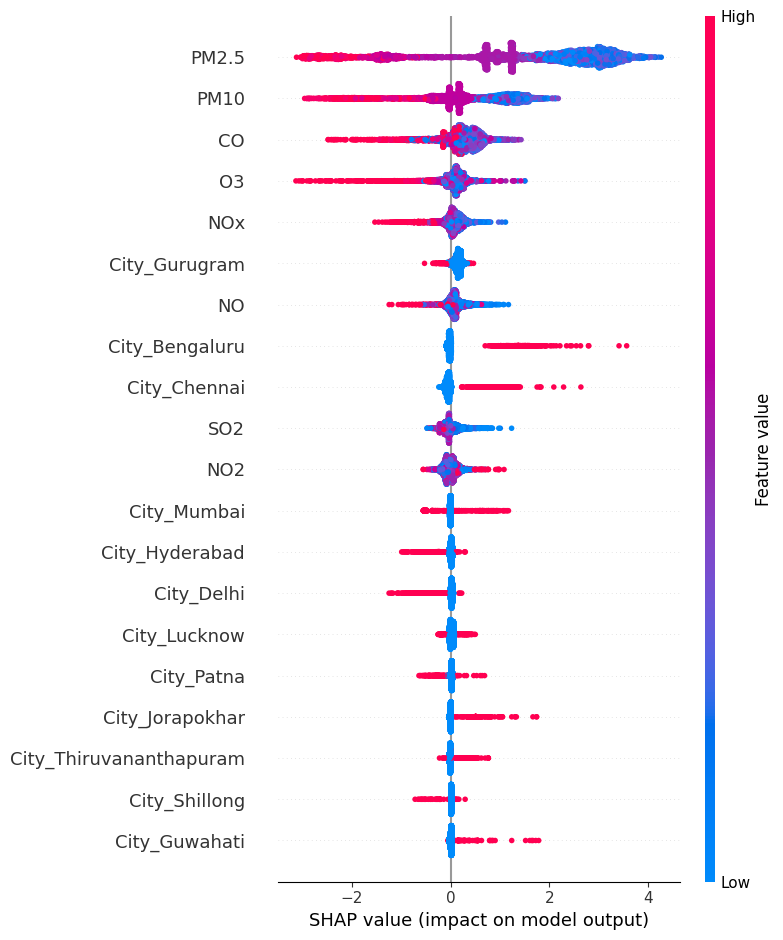

<Figure size 1200x400 with 0 Axes>

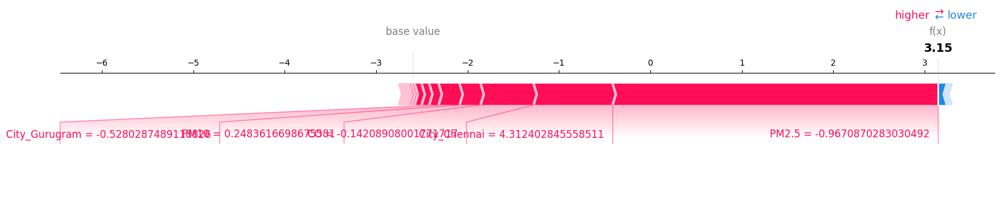

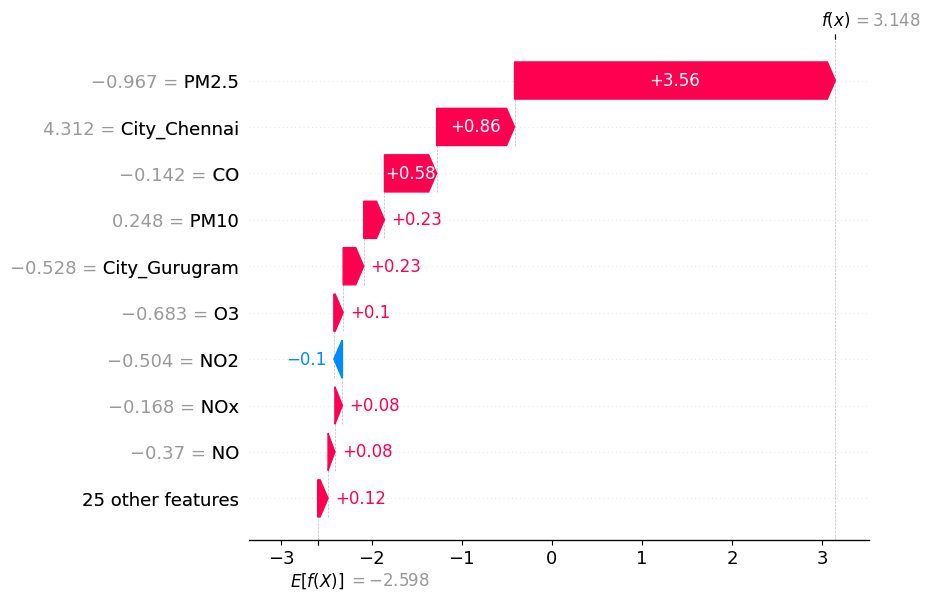

In [ ]:
import shap
import pandas as pd
import matplotlib.pyplot as plt

# Create SHAP explainer
explainer = shap.Explainer(xgb_model, X_train_scaled)

# Compute SHAP values
shap_values = explainer(X_test_scaled)

# Handle multi-class SHAP output
if len(shap_values.values.shape) == 3:  # If multi-class, pick a specific class
    class_index = 1  # Change this index to visualize a different class
    shap_values_selected = shap_values[:, :, class_index]
else:
    shap_values_selected = shap_values

# Convert SHAP values into a DataFrame
shap_df = pd.DataFrame(shap_values_selected.values, columns=X_train_scaled.columns)
shap_df['Prediction'] = y_pred_xgb  # Add predicted labels for reference

# Print first few rows of SHAP values
print(shap_df.head())

# SHAP Summary Plot (Feature Importance for Chosen Class)
shap.summary_plot(shap_values_selected, X_test_scaled, feature_names=X_train_scaled.columns)

# SHAP Force Plot (for a single prediction)
shap.initjs()
plt.figure(figsize=(12, 4))
shap.force_plot(explainer.expected_value[class_index], shap_values_selected[0].values, X_test_scaled.iloc[0, :], matplotlib=True)
plt.show()

# Alternative SHAP Waterfall Plot (Better for Individual Predictions)
shap.plots.waterfall(shap_values_selected[0])


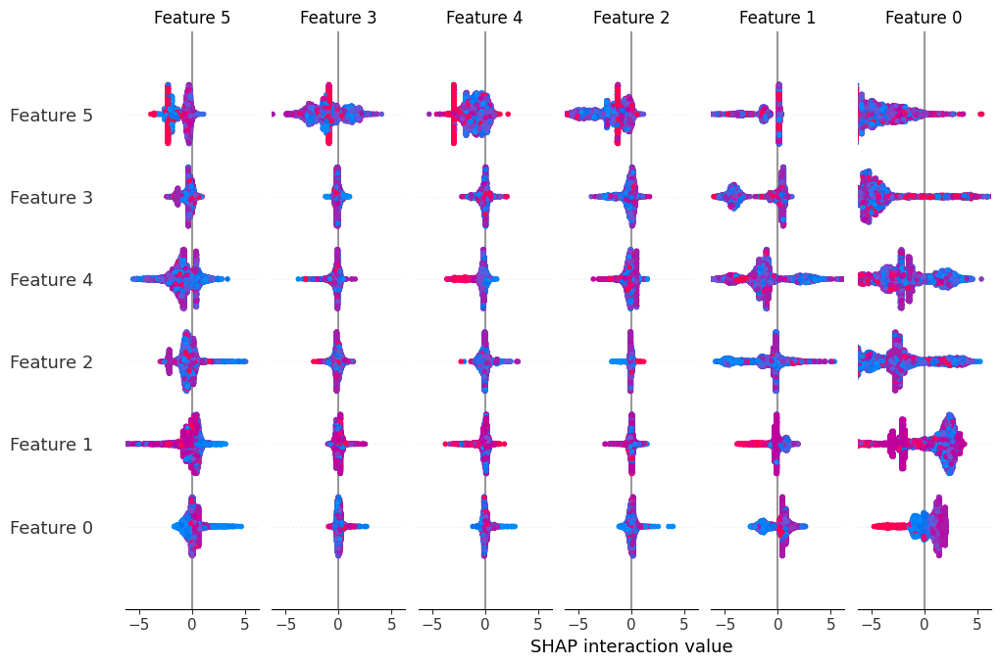

In [ ]:
import shap
import numpy as np
import matplotlib.pyplot as plt

# Initialize Tree SHAP Explainer
explainer = shap.Explainer(xgb_model)

# Compute SHAP values for the test set
shap_values = explainer(X_test_scaled)

# Summary plot (Global feature importance)
shap.summary_plot(shap_values, X_test_scaled)


In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Initialize LIME explainer
explainer = LimeTabularExplainer(
    training_data=X_train_scaled,
    feature_names=[f'Feature {i}' for i in range(X_train_scaled.shape[1])],
    class_names=[f'Class {i}' for i in range(len(np.unique(y_resampled_smote)))],
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(X_test_scaled[idx], xgb_model.predict_proba)

# Show explanation
exp.show_in_notebook()

# Print feature contributions
print(exp.as_list())


[('Feature 0 <= -0.95', 0.40074997783073085), ('Feature 28 <= -0.19', -0.06987396551533188), ('Feature 12 <= -0.22', -0.06412099809140254), ('Feature 31 <= -0.12', 0.05899828993070494), ('Feature 6 > 0.55', -0.05025470208661483), ('-0.72 < Feature 7 <= -0.14', -0.04485222709458102), ('Feature 30 <= -0.14', 0.044739522182702295), ('Feature 15 <= -0.12', 0.03989356937260664), ('Feature 8 <= -0.12', 0.033449864290411024), ('Feature 13 <= -0.09', 0.03000867374002113)]


In [ ]:
import numpy as np
import pandas as pd
from lime.lime_tabular import LimeTabularExplainer

# Ensure X_train_scaled and X_test_scaled have correct feature names
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_train.columns)

# Initialize LIME explainer with actual feature names
explainer = LimeTabularExplainer(
    training_data=X_train_scaled.values,  # Convert DataFrame to NumPy array
    feature_names=X_train_scaled.columns.tolist(),  # Use actual feature names
    class_names=[f'Class {i}' for i in range(len(np.unique(y_resampled_smote)))],
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(
    X_test_scaled.iloc[idx].values,  # Convert single row to NumPy array
    xgb_model.predict_proba
)

# Show explanation with proper labels
exp.show_in_notebook()

# Print feature contributions with labeled names
print(exp.as_list())


[('PM2.5 <= -0.95', 0.407843049711103), ('City_Bengaluru <= -0.22', -0.0792924018565578), ('-0.72 < O3 <= -0.14', -0.057386157508262585), ('SO2 > 0.55', -0.05457984908701776), ('City_Ernakulam <= -0.05', 0.05457950286923165), ('City_Visakhapatnam <= -0.19', 0.04491480629238837), ('City_Coimbatore <= -0.11', 0.04078369012303666), ('City_Mumbai <= -0.19', -0.03686883133850696), ('City_Kochi <= -0.03', -0.034816170064415466), ('City_Chandigarh <= -0.12', 0.03414739008156056)]


# **Decision Tree Gini**

In [ ]:

from sklearn.tree import DecisionTreeClassifier

dt_gini = DecisionTreeClassifier(criterion='gini', random_state=42)
dt_gini.fit(X_train_scaled, y_resampled_smote)

y_pred_dt_gini = dt_gini.predict(X_test_scaled)

print(f'Decision Tree (Gini) Accuracy: {accuracy_score(y_test, y_pred_dt_gini):.4f}')


Decision Tree (Gini) Accuracy: 0.7618


 99%|===================| 28162/28410 [00:13<00:00]       

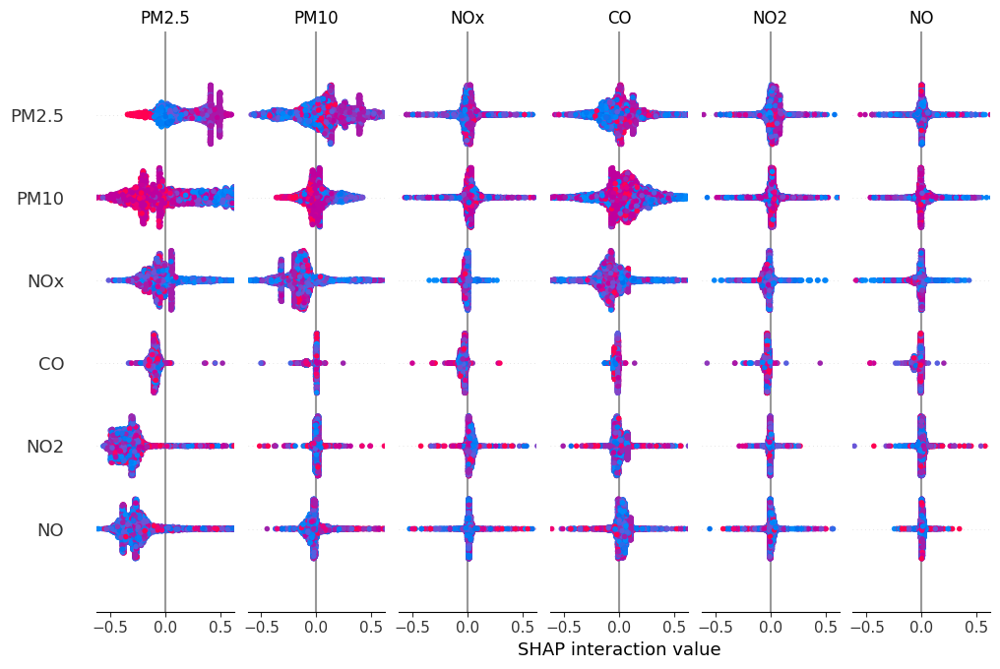

In [ ]:
import shap
import matplotlib.pyplot as plt

# Initialize Tree SHAP Explainer
explainer = shap.Explainer(dt_gini, X_train_scaled)

# Compute SHAP values for the test set
shap_values = explainer(X_test_scaled)

# Summary plot with proper feature names
shap.summary_plot(shap_values, X_test_scaled, feature_names=X_train_scaled.columns)


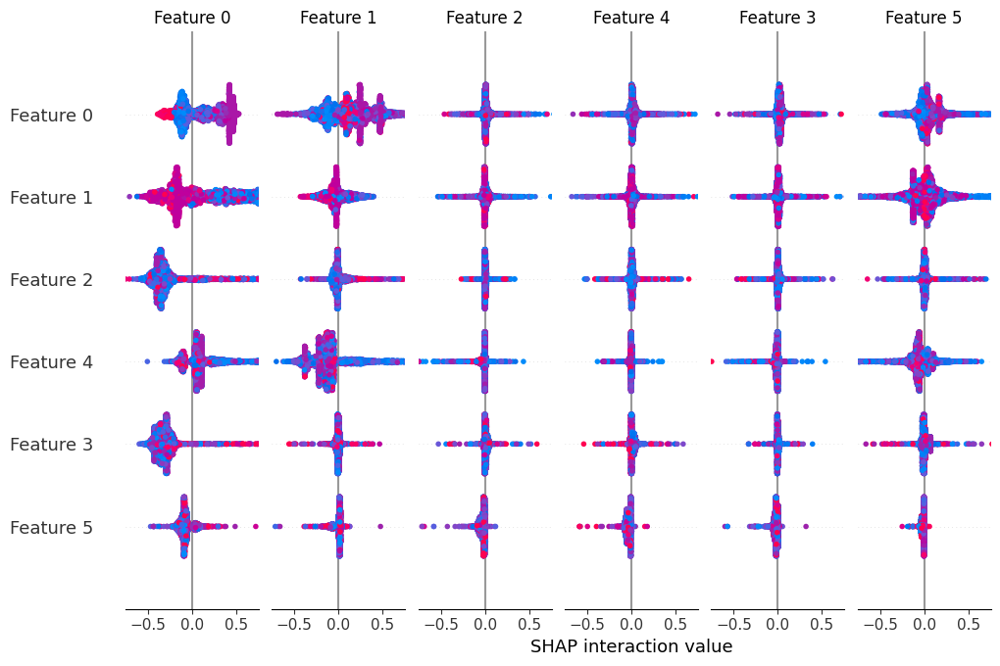

In [ ]:
import shap
import matplotlib.pyplot as plt

# Initialize Tree SHAP Explainer
explainer = shap.Explainer(dt_gini)

# Compute SHAP values for the test set
shap_values = explainer(X_test_scaled)

# Summary plot (Global feature importance)
shap.summary_plot(shap_values, X_test_scaled)


In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Initialize LIME explainer
explainer = LimeTabularExplainer(
    training_data=X_train_scaled,
    feature_names=[f'Feature {i}' for i in range(X_train_scaled.shape[1])],
    class_names=['Class 0', 'Class 1'],  # Adjust based on your classification problem
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(X_test_scaled[idx], dt_gini.predict_proba)

# Show explanation
exp.show_in_notebook()

# Print feature contributions
print(exp.as_list())


[('Feature 25 <= -0.03', 0.10319849739937809), ('Feature 16 > -0.27', 0.06169397011021629), ('Feature 19 <= -0.05', -0.046707506969786504), ('Feature 14 <= -0.19', -0.04028130902138855), ('Feature 8 <= -0.12', -0.03474445106056836), ('Feature 17 <= -0.11', -0.034487621552362936), ('Feature 33 <= -0.19', 0.03364306225823375), ('Feature 0 <= -0.95', 0.032475438950715536), ('Feature 21 <= -0.17', -0.031795184797874326), ('Feature 12 <= -0.22', 0.02976418634835635)]


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


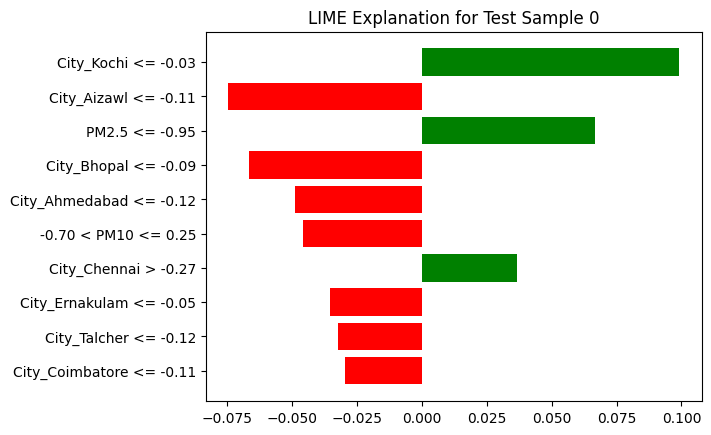

                    Feature  Contribution
0       City_Kochi <= -0.03      0.099164
1      City_Aizawl <= -0.11     -0.074426
2            PM2.5 <= -0.95      0.066786
3      City_Bhopal <= -0.09     -0.066615
4   City_Ahmedabad <= -0.12     -0.048875
5      -0.70 < PM10 <= 0.25     -0.045672
6      City_Chennai > -0.27      0.036804
7   City_Ernakulam <= -0.05     -0.035377
8     City_Talcher <= -0.12     -0.032073
9  City_Coimbatore <= -0.11     -0.029475


In [ ]:
from lime.lime_tabular import LimeTabularExplainer
import numpy as np
import matplotlib.pyplot as plt

# Ensure feature names are correctly labeled
feature_names = X_train_scaled.columns.tolist()  # Extract proper feature names

# Initialize LIME explainer with labeled features
explainer = LimeTabularExplainer(
    training_data=X_train_scaled.values,  # Ensure it's in numpy array format
    feature_names=feature_names,  # Use actual feature names
    class_names=[f'Class {cls}' for cls in np.unique(y_resampled_smote)],  # Adjust for multi-class
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(
    X_test_scaled.iloc[idx].values,  # Ensure correct format
    dt_gini.predict_proba,
    num_features=10  # Show top 10 most important features
)

# Show explanation with correct labels
exp.show_in_notebook()

# Save and display labeled explanation graph
fig = exp.as_pyplot_figure()
plt.title(f"LIME Explanation for Test Sample {idx}")
plt.show()

# Print feature contributions in a labeled table format
lime_df = pd.DataFrame(exp.as_list(), columns=['Feature', 'Contribution'])
print(lime_df)


# **Decision Tree Entropy**

In [ ]:
# prompt: give for C4.5

from sklearn.tree import DecisionTreeClassifier


dt_entropy = DecisionTreeClassifier(criterion='entropy', random_state=42)
dt_entropy.fit(X_train_scaled, y_resampled_smote)
y_pred_dt_entropy = dt_entropy.predict(X_test_scaled)
print(f'Decision Tree (Entropy) Accuracy: {accuracy_score(y_test, y_pred_dt_entropy):.4f}')


Decision Tree (Entropy) Accuracy: 0.7649


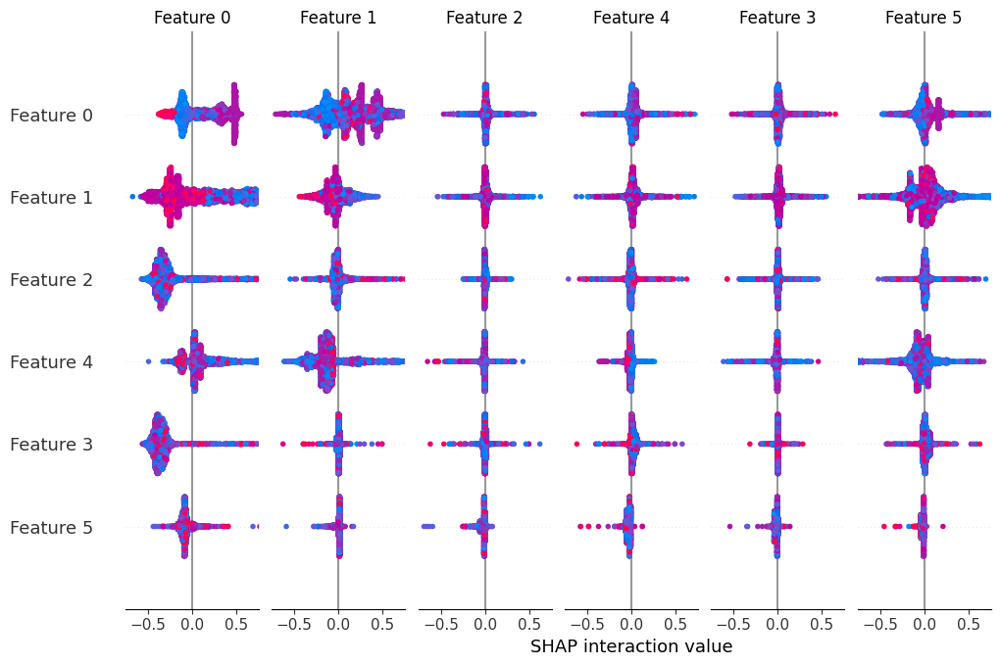

In [ ]:
import shap
import matplotlib.pyplot as plt

# Initialize Tree SHAP Explainer
explainer = shap.Explainer(dt_entropy)

# Compute SHAP values for the test set
shap_values = explainer(X_test_scaled)

# Summary plot (Global feature importance)
shap.summary_plot(shap_values, X_test_scaled)


In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Initialize LIME explainer
explainer = LimeTabularExplainer(
    training_data=X_train_scaled,
    feature_names=[f'Feature {i}' for i in range(X_train_scaled.shape[1])],
    class_names=['Class 0', 'Class 1'],  # Adjust based on your classification problem
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(X_test_scaled[idx], dt_entropy.predict_proba)

# Show explanation
exp.show_in_notebook()

# Print feature contributions
print(exp.as_list())


[('Feature 0 <= -0.95', 0.2594801450796916), ('Feature 25 <= -0.03', 0.11202892467022782), ('Feature 19 <= -0.05', -0.070963643147623), ('Feature 30 <= -0.14', 0.04482598927926617), ('-0.75 < Feature 4 <= -0.04', 0.04155140207607636), ('Feature 24 <= -0.13', 0.035412036501277167), ('-0.72 < Feature 7 <= -0.14', 0.03506367489984629), ('Feature 10 <= -0.21', 0.030579780244269637), ('Feature 29 <= -0.32', 0.02938330351358403), ('Feature 17 <= -0.11', 0.025197518701929305)]


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


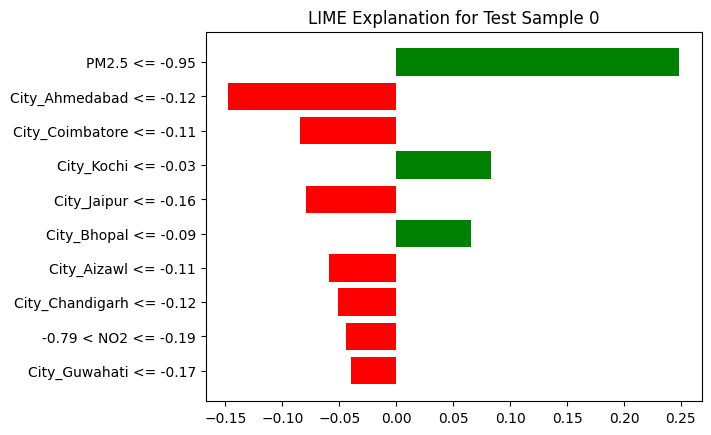

                    Feature  Contribution
0            PM2.5 <= -0.95      0.248621
1   City_Ahmedabad <= -0.12     -0.147451
2  City_Coimbatore <= -0.11     -0.084567
3       City_Kochi <= -0.03      0.083008
4      City_Jaipur <= -0.16     -0.079056
5      City_Bhopal <= -0.09      0.065315
6      City_Aizawl <= -0.11     -0.059015
7  City_Chandigarh <= -0.12     -0.051192
8      -0.79 < NO2 <= -0.19     -0.044524
9    City_Guwahati <= -0.17     -0.039650


In [ ]:
from lime.lime_tabular import LimeTabularExplainer
import numpy as np

# Initialize LIME explainer
explainer = LimeTabularExplainer(
    training_data=X_train_scaled.values,  # Convert to NumPy array
    feature_names=feature_names,  # Use actual feature names
    class_names=[f'Class {cls}' for cls in np.unique(y_resampled_smote)],  # Adjust for multi-class
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(
    X_test_scaled.iloc[idx].values,  # Ensure correct format
    dt_entropy.predict_proba,
    num_features=10  # Show top 10 features
)

# Show explanation
exp.show_in_notebook()

# Save and display labeled explanation graph
fig = exp.as_pyplot_figure()
plt.title(f"LIME Explanation for Test Sample {idx}")
plt.show()

# Print feature contributions in a labeled table format
lime_df = pd.DataFrame(exp.as_list(), columns=['Feature', 'Contribution'])
print(lime_df)


# **Bar Graph Comparison**

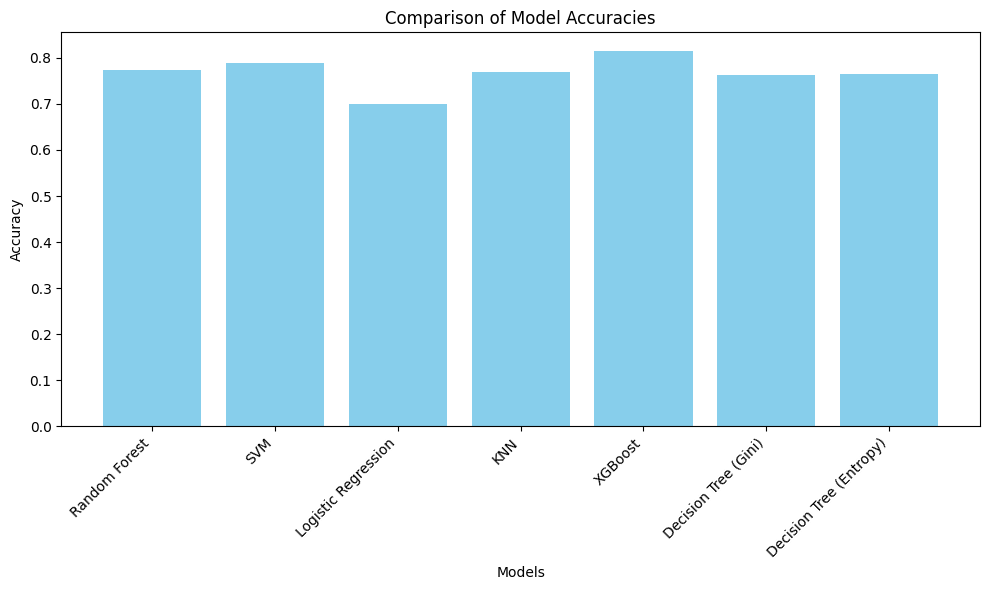

In [ ]:
# prompt: USE BAR GRAPH TO COMPARE THE MODELS

import matplotlib.pyplot as plt

# Accuracy scores (replace with your actual scores)
models = ['Random Forest', 'SVM', 'Logistic Regression', 'KNN', 'XGBoost', 'Decision Tree (Gini)', 'Decision Tree (Entropy)']
accuracy_scores = [accuracy_score(y_test, y_pred_rf), accuracy_score(y_test, y_pred_svm),
                   accuracy_score(y_test, y_pred_lr), accuracy_score(y_test, y_pred_knn),
                   accuracy_score(y_test, y_pred_xgb), accuracy_score(y_test, y_pred_dt_gini), accuracy_score(y_test, y_pred_dt_entropy)]

# Create the bar graph
plt.figure(figsize=(10, 6))
plt.bar(models, accuracy_scores, color='skyblue')
plt.xlabel("Models")
plt.ylabel("Accuracy")
plt.title("Comparison of Model Accuracies")
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout() # Adjust layout to prevent labels from overlapping
plt.show()


              precision    recall  f1-score   support

         0.0       0.90      0.75      0.82      2426
         1.0       0.77      0.82      0.79      1592
         2.0       0.50      0.71      0.59       312
         3.0       0.73      0.75      0.74       145
         4.0       0.56      0.79      0.66       258
         5.0       0.00      0.00      0.00         2

    accuracy                           0.77      4735
   macro avg       0.58      0.64      0.60      4735
weighted avg       0.80      0.77      0.78      4735



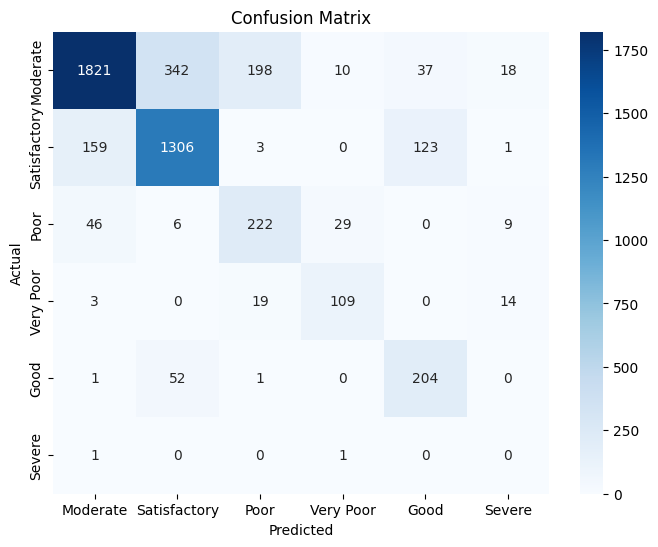

In [ ]:
# prompt: give evaluation matrix

from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

# Assuming y_test and y_pred_rf are defined (replace with your actual predictions)

# Classification Report
print(classification_report(y_test, y_pred_rf))

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred_rf)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=oe.categories_[0], yticklabels=oe.categories_[0])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


# **Federated Learning**

In [ ]:
!pip install tensorflow-federated


# **SVM K fold**

In [ ]:
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score


kf = KFold(n_splits=5, shuffle=True, random_state=42)  # 5 folds, shuffle data

svm_accuracy_scores = []

for train_index, val_index in kf.split(X_train_scaled):
    X_train_fold, X_val_fold = X_train_scaled[train_index], X_train_scaled[val_index]
    y_train_fold, y_val_fold = y_resampled_smote[train_index], y_resampled_smote[val_index]

    svm = SVC(kernel='rbf', gamma='scale', C=1, random_state=42) # Use the best parameters you found
    svm.fit(X_train_fold, y_train_fold)

    y_pred_svm = svm.predict(X_val_fold)

    accuracy = accuracy_score(y_val_fold, y_pred_svm)
    svm_accuracy_scores.append(accuracy)

print("SVM Accuracy scores for each fold:", svm_accuracy_scores)

average_accuracy = np.mean(svm_accuracy_scores)
print(f"Average SVM Accuracy across all folds: {average_accuracy:.4f}")

SVM Accuracy scores for each fold: [0.8533030805480408, 0.8588009424906188, 0.8599354219390872, 0.8556593070948599, 0.8513702216791761]
Average SVM Accuracy across all folds: 0.8558


In [ ]:
import shap
import numpy as np
import matplotlib.pyplot as plt

# Kernel SHAP requires a function that outputs probabilities
svm = SVC(kernel='rbf', gamma='scale', C=1, probability=True, random_state=42)
svm.fit(X_train_scaled, y_resampled_smote)

# Create SHAP Explainer using Kernel SHAP
explainer = shap.KernelExplainer(svm.predict_proba, shap.sample(X_train_scaled, 100))  # Use a subset for efficiency

# Compute SHAP values for test set
shap_values = explainer.shap_values(X_test_scaled[:50])  # Only using 50 samples for speed

# Summary plot (Global feature importance)
shap.summary_plot(shap_values, X_test_scaled[:50])


  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Initialize LIME explainer
explainer = LimeTabularExplainer(
    training_data=X_train_scaled,
    feature_names=[f'Feature {i}' for i in range(X_train_scaled.shape[1])],
    class_names=['Class 0', 'Class 1'],  # Adjust based on your classification problem
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(X_test_scaled[idx], svm.predict_proba)

# Show explanation
exp.show_in_notebook()

# Print feature contributions
print(exp.as_list())


[('Feature 0 <= -0.95', 0.4242243164235955), ('Feature 19 <= -0.05', -0.1342484606429236), ('Feature 24 <= -0.13', 0.10439504074340135), ('Feature 11 <= -0.19', 0.0909178762307568), ('Feature 9 <= -0.11', 0.08655383981566064), ('Feature 14 <= -0.19', 0.07916038833856753), ('Feature 31 <= -0.12', 0.0691045131065276), ('Feature 18 <= -0.24', 0.06525117811588294), ('Feature 17 <= -0.11', -0.06115925842609), ('Feature 21 <= -0.17', 0.05973534889495308)]


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(


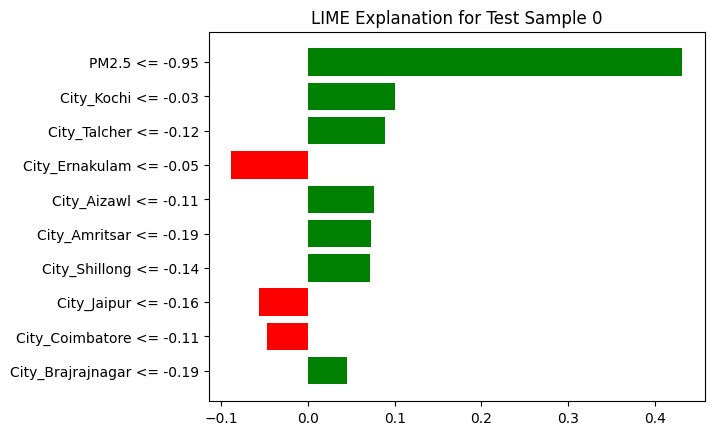

                      Feature  Contribution
0              PM2.5 <= -0.95      0.431918
1         City_Kochi <= -0.03      0.100806
2       City_Talcher <= -0.12      0.089269
3     City_Ernakulam <= -0.05     -0.088553
4        City_Aizawl <= -0.11      0.075660
5      City_Amritsar <= -0.19      0.072387
6      City_Shillong <= -0.14      0.071333
7        City_Jaipur <= -0.16     -0.056658
8    City_Coimbatore <= -0.11     -0.047109
9  City_Brajrajnagar <= -0.19      0.044906


In [ ]:
from lime.lime_tabular import LimeTabularExplainer
import numpy as np

# Ensure feature names are labeled correctly
feature_names = X_train_scaled.columns.tolist()  # Extract actual feature names

# Initialize LIME explainer with labeled features
explainer = LimeTabularExplainer(
    training_data=X_train_scaled.values,  # Convert to NumPy array
    feature_names=feature_names,  # Use actual feature names
    class_names=[f'Class {cls}' for cls in np.unique(y_resampled_smote)],  # Adjust for multi-class
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(
    X_test_scaled.iloc[idx].values,  # Ensure correct format
    svm.predict_proba,
    num_features=10  # Show top 10 features
)

# Show explanation
exp.show_in_notebook()

# Save and display labeled explanation graph
fig = exp.as_pyplot_figure()
plt.title(f"LIME Explanation for Test Sample {idx}")
plt.show()

# Print feature contributions in a labeled table format
lime_df = pd.DataFrame(exp.as_list(), columns=['Feature', 'Contribution'])
print(lime_df)


# **XG Boost K Fold**

In [ ]:
from xgboost import XGBClassifier
from sklearn.model_selection import cross_val_score, KFold
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score
import numpy as np

# Verify target variable encoding (for debugging)
print("Unique values in y_resampled_smote:", np.unique(y_resampled_smote))
print("Data type of y_resampled_smote:", y_resampled_smote.dtype)

# Define K-Fold cross-validator
k = 5  # Number of folds
kf = KFold(n_splits=k, shuffle=True, random_state=42)

# Define XGBoost classifier (removed use_label_encoder)
xgb = XGBClassifier(eval_metric='mlogloss', random_state=42)

# Define scoring metrics
scoring = {
    'accuracy': make_scorer(accuracy_score),
    'precision': make_scorer(precision_score, average='weighted', zero_division=1),
    'recall': make_scorer(recall_score, average='weighted', zero_division=1),
    'f1': make_scorer(f1_score, average='weighted', zero_division=1)
}

# Perform cross-validation
cv_results = cross_val_score(xgb, X_train_scaled, y_resampled_smote, cv=kf, scoring='accuracy')
precision_scores = cross_val_score(xgb, X_train_scaled, y_resampled_smote, cv=kf, scoring=scoring['precision'])
recall_scores = cross_val_score(xgb, X_train_scaled, y_resampled_smote, cv=kf, scoring=scoring['recall'])
f1_scores = cross_val_score(xgb, X_train_scaled, y_resampled_smote, cv=kf, scoring=scoring['f1'])

# Print cross-validation results
print(f'XGBoost Cross-Validation Accuracies: {cv_results}')
print(f'Mean Accuracy: {cv_results.mean():.4f}')
print(f'Mean Precision: {precision_scores.mean():.4f}')
print(f'Mean Recall: {recall_scores.mean():.4f}')
print(f'Mean F1 Score: {f1_scores.mean():.4f}')
print(f'Standard Deviation of Accuracy: {cv_results.std():.4f}')

Unique values in y_resampled_smote: [0. 1. 2. 3. 4. 5.]
Data type of y_resampled_smote: float64
XGBoost Cross-Validation Accuracies: [0.9287896  0.9320185  0.93402566 0.9287896  0.92834701]
Mean Accuracy: 0.9304
Mean Precision: 0.9299
Mean Recall: 0.9304
Mean F1 Score: 0.9299
Standard Deviation of Accuracy: 0.0022


100%|===================| 28385/28410 [11:44<00:00]       

TypeError: only integer scalar arrays can be converted to a scalar index

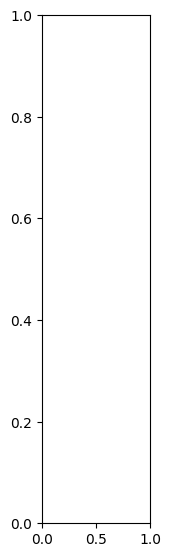

In [ ]:
import shap
import matplotlib.pyplot as plt
import numpy as np
from xgboost import XGBClassifier

# Train the XGBoost model on the full dataset after cross-validation
xgb_model = XGBClassifier(eval_metric='mlogloss', random_state=42)
xgb_model.fit(X_train_scaled, y_resampled_smote)

# Extract feature names
feature_names = X_train_scaled.columns.tolist()  # Ensures correct labeling

# Create SHAP explainer using Tree SHAP
explainer = shap.Explainer(xgb_model, X_train_scaled)

# Compute SHAP values for test set
shap_values = explainer(X_test_scaled)

# Generate SHAP summary plot with feature labels
shap.summary_plot(shap_values, X_test_scaled, feature_names=feature_names)

# Add title for better visualization
plt.title("SHAP Summary Plot for XGBoost (Labeled Features)")
plt.show()


In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Initialize LIME explainer with proper feature labels
explainer = LimeTabularExplainer(
    training_data=X_train_scaled.to_numpy(),  # Convert DataFrame to NumPy array
    feature_names=feature_names,  # Ensures proper feature labels
    class_names=[str(cls) for cls in np.unique(y_resampled_smote)],  # Adjusts class labels
    mode='classification'
)

# Explain a single test instance (e.g., first instance in test set)
idx = 0  # Choose an instance to explain
exp = explainer.explain_instance(X_test_scaled.iloc[idx].to_numpy(), xgb_model.predict_proba)

# Show explanation graph with labeled features
exp.show_in_notebook()

# Print feature contributions
print("\nLIME Explanation (Feature Contributions):")
for feature, contribution in exp.as_list():
    print(f"{feature}: {contribution:.4f}")



LIME Explanation (Feature Contributions):
PM2.5 <= -0.95: 0.4125
City_Ernakulam <= -0.05: 0.0727
City_Bengaluru <= -0.22: -0.0658
-0.72 < O3 <= -0.14: -0.0557
SO2 > 0.55: -0.0472
City_Kochi <= -0.03: -0.0435
City_Coimbatore <= -0.11: 0.0410
City_Mumbai <= -0.19: -0.0360
City_Visakhapatnam <= -0.19: 0.0339
City_Chennai > -0.27: 0.0305


# **MLP Classifier**

In [ ]:
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report

# Define MLP classifier
mlp = MLPClassifier(hidden_layer_sizes=(100,), activation='relu', solver='adam',
                    max_iter=500, random_state=42)

# Train the MLP model
mlp.fit(X_train_scaled, y_resampled_smote)

# Predict on test data
y_pred_mlp = mlp.predict(X_test_scaled)

# Print evaluation metrics
print(f'MLP Accuracy: {accuracy_score(y_test, y_pred_mlp):.4f}')
print(f'MLP Precision: {precision_score(y_test, y_pred_mlp, average="weighted", zero_division=1):.4f}')
print(f'MLP Recall: {recall_score(y_test, y_pred_mlp, average="weighted", zero_division=1):.4f}')
print(f'MLP F1 Score: {f1_score(y_test, y_pred_mlp, average="weighted", zero_division=1):.4f}')
print("\nConfusion Matrix:\n", confusion_matrix(y_test, y_pred_mlp))
print("\nClassification Report:\n", classification_report(y_test, y_pred_mlp))

MLP Accuracy: 0.8156
MLP Precision: 0.8243
MLP Recall: 0.8156
MLP F1 Score: 0.8185

Confusion Matrix:
 [[2010  257  122   13   23    1]
 [ 148 1352    3    1   88    0]
 [  70    4  209   28    1    0]
 [   2    1   39  102    0    1]
 [   3   65    1    0  189    0]
 [   1    0    0    1    0    0]]

Classification Report:
               precision    recall  f1-score   support

         0.0       0.90      0.83      0.86      2426
         1.0       0.81      0.85      0.83      1592
         2.0       0.56      0.67      0.61       312
         3.0       0.70      0.70      0.70       145
         4.0       0.63      0.73      0.68       258
         5.0       0.00      0.00      0.00         2

    accuracy                           0.82      4735
   macro avg       0.60      0.63      0.61      4735
weighted avg       0.82      0.82      0.82      4735



  0%|          | 0/10 [00:00<?, ?it/s]

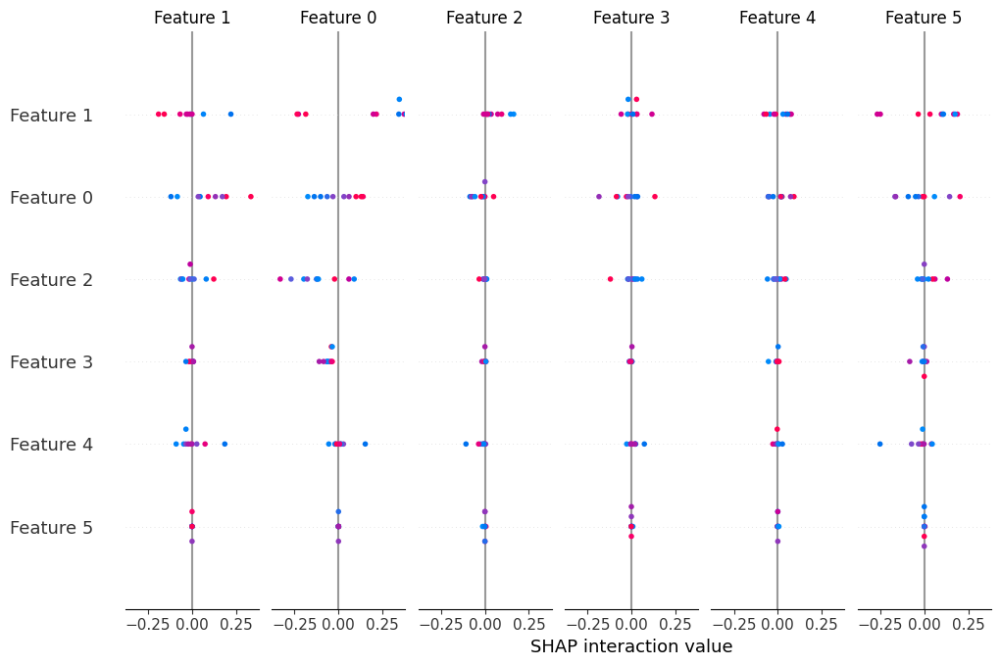

In [ ]:
import shap

# Initialize SHAP explainer (KernelExplainer for MLPClassifier)
explainer = shap.KernelExplainer(mlp.predict_proba, X_train_scaled[:50])  # Use a small subset for efficiency

# Compute SHAP values
shap_values = explainer.shap_values(X_test_scaled[:10])  # Explain first 10 samples

# Summary Plot (Global Feature Importance)
shap.summary_plot(shap_values, X_test_scaled[:10])


In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Initialize LIME explainer
explainer = LimeTabularExplainer(
    training_data=X_train_scaled,
    feature_names=[f'Feature {i}' for i in range(X_train_scaled.shape[1])],
    class_names=[str(cls) for cls in np.unique(y_resampled_smote)],
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(X_test_scaled[idx], mlp.predict_proba)

# Show explanation
exp.show_in_notebook()

# Print feature contributions
print(exp.as_list())


[('Feature 19 <= -0.05', -0.3344734674548351), ('Feature 0 <= -0.95', 0.3064839748538307), ('Feature 25 <= -0.03', -0.2765127964119735), ('Feature 17 <= -0.11', -0.2635297650459805), ('Feature 30 <= -0.14', -0.16866634186417637), ('Feature 12 <= -0.22', -0.12150174021402596), ('Feature 21 <= -0.17', 0.11135409097373551), ('Feature 23 <= -0.16', -0.09903634483471704), ('Feature 32 <= -0.20', -0.08990580665677199), ('Feature 31 <= -0.12', 0.08869532889922983)]


In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Initialize LIME explainer with labeled features
explainer = LimeTabularExplainer(
    training_data=X_train_scaled.to_numpy(),
    feature_names=feature_names,
    class_names=[str(cls) for cls in np.unique(y_resampled_smote)],
    mode='classification'
)

# Explain a single test instance (e.g., first instance in test set)
idx = 0
exp = explainer.explain_instance(X_test_scaled.iloc[idx].to_numpy(), mlp.predict_proba)

# Show explanation graph with labeled features
exp.show_in_notebook()

# Print feature contributions
print("\nLIME Explanation (Feature Contributions):")
for feature, contribution in exp.as_list():
    print(f"{feature}: {contribution:.4f}")


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(



LIME Explanation (Feature Contributions):
City_Kochi <= -0.03: -0.6352
City_Ernakulam <= -0.05: -0.5257
PM2.5 <= -0.95: 0.3094
City_Coimbatore <= -0.11: -0.2710
City_Shillong <= -0.14: -0.1378
City_Aizawl <= -0.11: -0.1272
City_Bengaluru <= -0.22: -0.1123
City_Amritsar <= -0.19: 0.1108
City_Hyderabad <= -0.25: 0.1093
City_Jaipur <= -0.16: -0.0960


# **ADA Boost**

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import cross_val_score, KFold
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score

# Define K-Fold cross-validator
k = 5  # Number of folds
kf = KFold(n_splits=k, shuffle=True, random_state=42)

# Define AdaBoost classifier
adaboost = AdaBoostClassifier(n_estimators=50, random_state=42)

# Define scoring metrics
scoring = {
    'accuracy': make_scorer(accuracy_score),
    'precision': make_scorer(precision_score, average='weighted', zero_division=1),
    'recall': make_scorer(recall_score, average='weighted', zero_division=1),
    'f1': make_scorer(f1_score, average='weighted', zero_division=1)
}

# Perform cross-validation
cv_results = cross_val_score(adaboost, X_train_scaled, y_resampled_smote, cv=kf, scoring='accuracy')
precision_scores = cross_val_score(adaboost, X_train_scaled, y_resampled_smote, cv=kf, scoring=scoring['precision'])
recall_scores = cross_val_score(adaboost, X_train_scaled, y_resampled_smote, cv=kf, scoring=scoring['recall'])
f1_scores = cross_val_score(adaboost, X_train_scaled, y_resampled_smote, cv=kf, scoring=scoring['f1'])

# Print cross-validation results
print(f'AdaBoost Cross-Validation Accuracies: {cv_results}')
print(f'Mean Accuracy: {cv_results.mean():.4f}')
print(f'Mean Precision: {precision_scores.mean():.4f}')
print(f'Mean Recall: {recall_scores.mean():.4f}')
print(f'Mean F1 Score: {f1_scores.mean():.4f}')
print(f'Standard Deviation of Accuracy: {cv_results.std():.4f}')

AdaBoost Cross-Validation Accuracies: [0.60493935 0.67562615 0.64412252 0.66436862 0.66172107]
Mean Accuracy: 0.6502
Mean Precision: 0.6694
Mean Recall: 0.6502
Mean F1 Score: 0.6474
Standard Deviation of Accuracy: 0.0248


  0%|          | 0/50 [00:00<?, ?it/s]

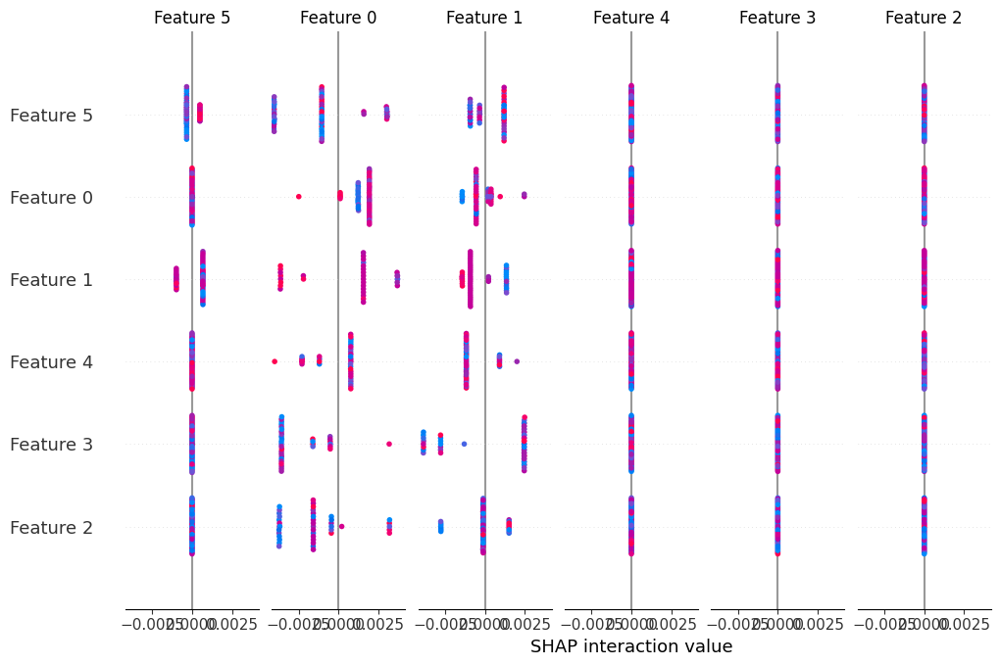

In [ ]:
import shap

# Initialize Kernel SHAP explainer
explainer = shap.KernelExplainer(adaboost.predict_proba, shap.kmeans(X_train_scaled, 10))

# Compute SHAP values for a subset of the test set
shap_values = explainer.shap_values(X_test_scaled[:50])  # Using a smaller sample for efficiency

# Summary Plot (Global Feature Importance)
shap.summary_plot(shap_values, X_test_scaled[:50])


In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Initialize LIME explainer
explainer = LimeTabularExplainer(
    training_data=X_train_scaled,
    feature_names=[f'Feature {i}' for i in range(X_train_scaled.shape[1])],
    class_names=[str(cls) for cls in np.unique(y_resampled_smote)],
    mode='classification'
)

# Explain a single test instance
idx = 0  # Index of the test sample to explain
exp = explainer.explain_instance(X_test_scaled[idx], adaboost.predict_proba)

# Show explanation
exp.show_in_notebook()

# Print feature contributions
print(exp.as_list())


[('Feature 0 <= -0.95', 0.004450781328110319), ('Feature 13 <= -0.09', 0.0003897969672891143), ('Feature 19 <= -0.05', 0.00037486065763616723), ('Feature 11 <= -0.19', 0.00031195759442112703), ('Feature 33 <= -0.19', 0.00022914952302181582), ('Feature 12 <= -0.22', -0.00020415081023427323), ('Feature 16 > -0.27', 0.00019335614008814776), ('-0.18 < Feature 5 <= 0.52', -0.00016738208513501757), ('Feature 26 <= -0.18', 0.00016498083316288963), ('Feature 25 <= -0.03', -0.0001120323298134718)]


# **Bagging Classifier**

In [ ]:
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report

# Replace 'base_estimator' with 'estimator'
bagging = BaggingClassifier(estimator=DecisionTreeClassifier(), n_estimators=50, random_state=42, n_jobs=-1)

# Train the Bagging model
bagging.fit(X_train_scaled, y_resampled_smote)

# Predict on test data
y_pred_bagging = bagging.predict(X_test_scaled)

# Print evaluation metrics
print(f'Bagging Accuracy: {accuracy_score(y_test, y_pred_bagging):.4f}')
print(f'Bagging Precision: {precision_score(y_test, y_pred_bagging, average="weighted", zero_division=1):.4f}')
print(f'Bagging Recall: {recall_score(y_test, y_pred_bagging, average="weighted", zero_division=1):.4f}')
print(f'Bagging F1 Score: {f1_score(y_test, y_pred_bagging, average="weighted", zero_division=1):.4f}')
print("\nConfusion Matrix:\n", confusion_matrix(y_test, y_pred_bagging))
print("\nClassification Report:\n", classification_report(y_test, y_pred_bagging))

Bagging Accuracy: 0.8129
Bagging Precision: 0.8189
Bagging Recall: 0.8129
Bagging F1 Score: 0.8152

Confusion Matrix:
 [[2034  246  112   14   19    1]
 [ 174 1325    6    0   87    0]
 [  71    5  193   43    0    0]
 [   4    0   34  105    0    2]
 [   8   58    0    0  192    0]
 [   2    0    0    0    0    0]]

Classification Report:
               precision    recall  f1-score   support

         0.0       0.89      0.84      0.86      2426
         1.0       0.81      0.83      0.82      1592
         2.0       0.56      0.62      0.59       312
         3.0       0.65      0.72      0.68       145
         4.0       0.64      0.74      0.69       258
         5.0       0.00      0.00      0.00         2

    accuracy                           0.81      4735
   macro avg       0.59      0.63      0.61      4735
weighted avg       0.82      0.81      0.82      4735



  0%|          | 0/50 [00:00<?, ?it/s]

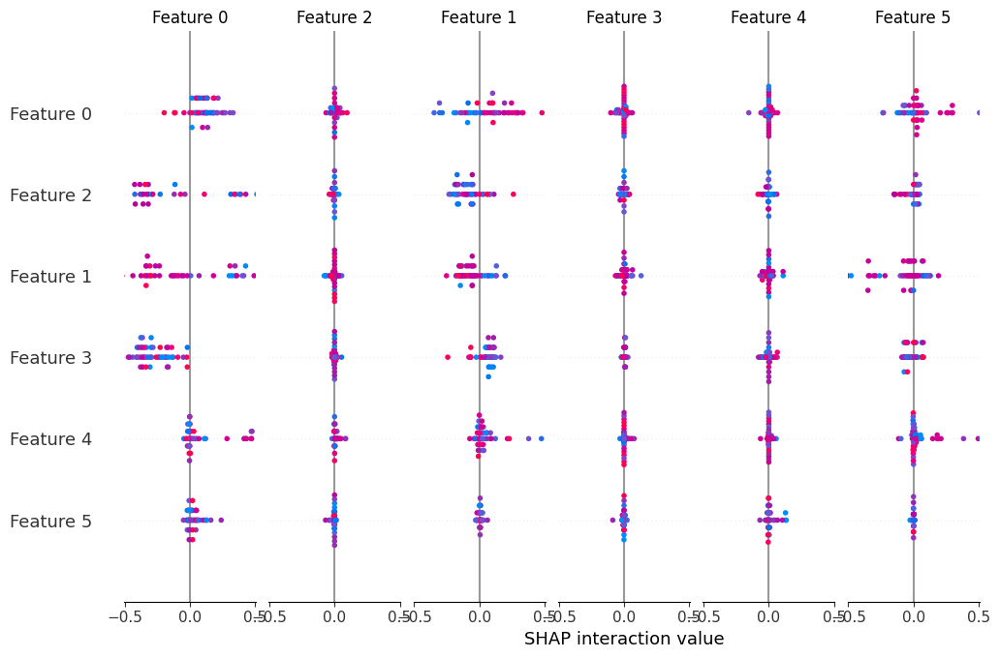

In [ ]:
import shap

# Initialize Kernel SHAP explainer
explainer = shap.KernelExplainer(bagging.predict_proba, shap.kmeans(X_train_scaled, 10))

# Compute SHAP values for a subset of the test set
shap_values = explainer.shap_values(X_test_scaled[:50])  # Using a smaller sample for efficiency

# Summary Plot (Global Feature Importance)
shap.summary_plot(shap_values, X_test_scaled[:50])


In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Initialize LIME explainer
explainer = LimeTabularExplainer(
    training_data=X_train_scaled,
    feature_names=[f'Feature {i}' for i in range(X_train_scaled.shape[1])],
    class_names=[str(cls) for cls in np.unique(y_resampled_smote)],
    mode='classification'
)

# Explain a single test instance
idx = 0  # Choose any test sample index
exp = explainer.explain_instance(X_test_scaled[idx], bagging.predict_proba)

# Show explanation
exp.show_in_notebook()

# Print feature contributions
print(exp.as_list())


[('Feature 0 <= -0.95', 0.22343788265303538), ('Feature 8 <= -0.12', -0.0604537581375271), ('Feature 16 > -0.27', 0.059659649510876246), ('Feature 15 <= -0.12', 0.0341601091890354), ('Feature 32 <= -0.20', 0.026915194155639696), ('Feature 22 <= -0.25', 0.022906585874227114), ('Feature 10 <= -0.21', -0.022174058132041475), ('Feature 27 <= -0.40', -0.022052716173653748), ('-0.72 < Feature 7 <= -0.14', 0.0194542277293359), ('Feature 19 <= -0.05', 0.012527675125536323)]


# **Logistic Regression K Fold**

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score, KFold
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score

# Define K-Fold cross-validator
k = 5  # Number of folds
kf = KFold(n_splits=k, shuffle=True, random_state=42)

# Define Logistic Regression classifier
lr = LogisticRegression(max_iter=1000, penalty='l2', solver='lbfgs', random_state=42)

# Define scoring metrics
scoring = {
    'accuracy': make_scorer(accuracy_score),
    'precision': make_scorer(precision_score, average='weighted', zero_division=1),
    'recall': make_scorer(recall_score, average='weighted', zero_division=1),
    'f1': make_scorer(f1_score, average='weighted', zero_division=1)
}

# Perform cross-validation
cv_results = cross_val_score(lr, X_train_scaled, y_resampled_smote, cv=kf, scoring='accuracy')
precision_scores = cross_val_score(lr, X_train_scaled, y_resampled_smote, cv=kf, scoring=scoring['precision'])
recall_scores = cross_val_score(lr, X_train_scaled, y_resampled_smote, cv=kf, scoring=scoring['recall'])
f1_scores = cross_val_score(lr, X_train_scaled, y_resampled_smote, cv=kf, scoring=scoring['f1'])

# Print cross-validation results
print(f'Logistic Regression Cross-Validation Accuracies: {cv_results}')
print(f'Mean Accuracy: {cv_results.mean():.4f}')
print(f'Mean Precision: {precision_scores.mean():.4f}')
print(f'Mean Recall: {recall_scores.mean():.4f}')
print(f'Mean F1 Score: {f1_scores.mean():.4f}')
print(f'Standard Deviation of Accuracy: {cv_results.std():.4f}')

Logistic Regression Cross-Validation Accuracies: [0.72737586 0.73435727 0.73025569 0.73435727 0.7226392 ]
Mean Accuracy: 0.7298
Mean Precision: 0.7302
Mean Recall: 0.7298
Mean F1 Score: 0.7284
Standard Deviation of Accuracy: 0.0044


  0%|          | 0/50 [00:00<?, ?it/s]

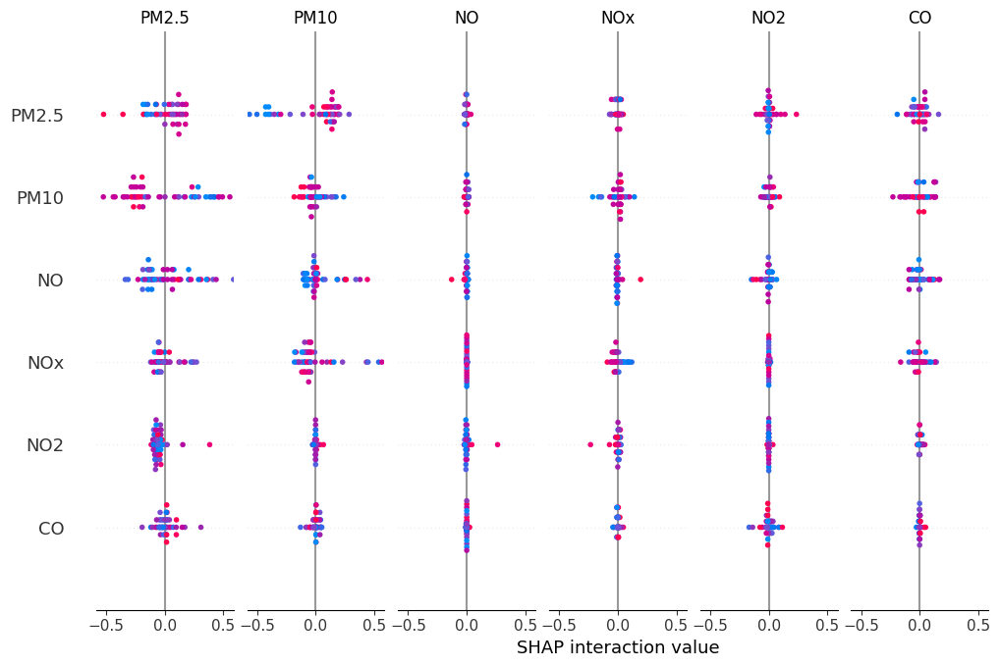

In [ ]:
import shap

# Ensure the logistic regression model is trained
lr.fit(X_train_scaled, y_resampled_smote)

# Initialize Kernel SHAP explainer
explainer = shap.KernelExplainer(lr.predict_proba, X_train_scaled[:100])  # Using 100 samples for efficiency

# Compute SHAP values for a subset of the test set
shap_values = explainer.shap_values(X_test_scaled[:50])  # Limit test samples for speed

# Summary Plot (Global Feature Importance)
shap.summary_plot(shap_values, X_test_scaled[:50])


In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Ensure the logistic regression model is trained
lr.fit(X_train_scaled, y_resampled_smote)

# Initialize LIME explainer
explainer = LimeTabularExplainer(
    training_data=X_train_scaled,
    feature_names=[f'Feature {i}' for i in range(X_train_scaled.shape[1])],
    class_names=[str(cls) for cls in np.unique(y_resampled_smote)],
    mode='classification'
)

# Explain a single test instance
idx = 0  # Choose a test sample index
exp = explainer.explain_instance(X_test_scaled[idx], lr.predict_proba)

# Show explanation
exp.show_in_notebook()

# Print feature contributions
print(exp.as_list())


[('Feature 0 <= -0.95', 0.4934785039550881), ('Feature 30 <= -0.14', 0.11844400011338636), ('Feature 14 <= -0.19', 0.09082534527986186), ('Feature 31 <= -0.12', 0.0705148881755567), ('Feature 18 <= -0.24', 0.060016060924077436), ('Feature 13 <= -0.09', 0.05913225459255208), ('Feature 32 <= -0.20', -0.05758546455065234), ('Feature 9 <= -0.11', 0.05152851424016755), ('Feature 23 <= -0.16', -0.05063734053357356), ('Feature 25 <= -0.03', 0.03334401523824881)]


# **AI**

In [ ]:
pip install shap

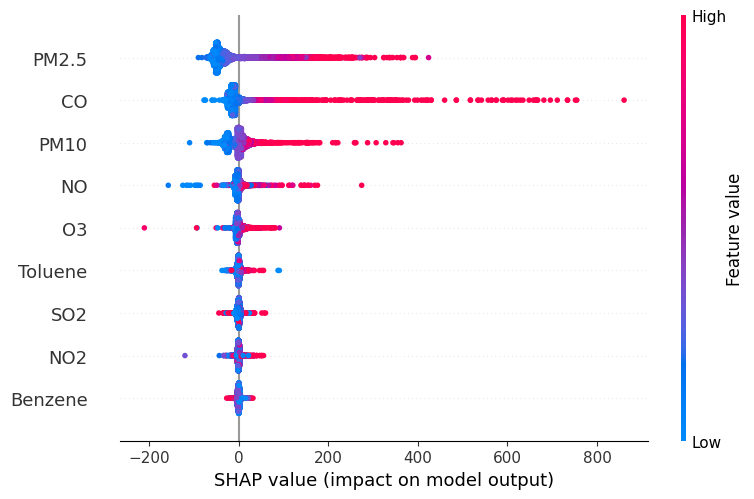

In [ ]:
import pandas as pd
import shap
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer

# Load the dataset
  # Update path
df = pd.read_csv('city_day.csv')

# Convert Date to datetime
df["Date"] = pd.to_datetime(df["Date"])

# Drop rows with missing AQI values
df = df.dropna(subset=["AQI"])

# Select features and target variable
features = ["PM2.5", "PM10", "NO2", "NO", "CO", "SO2", "O3", "Benzene", "Toluene"]
X = df[features]
y = df["AQI"]

# Handle missing values
imputer = SimpleImputer(strategy="mean")
X = imputer.fit_transform(X)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train an XGBoost model
model = xgb.XGBRegressor(objective="reg:squarederror", n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Explain predictions using SHAP
explainer = shap.Explainer(model)
shap_values = explainer(X_test)

# Plot feature importance
shap.summary_plot(shap_values, X_test, feature_names=features)


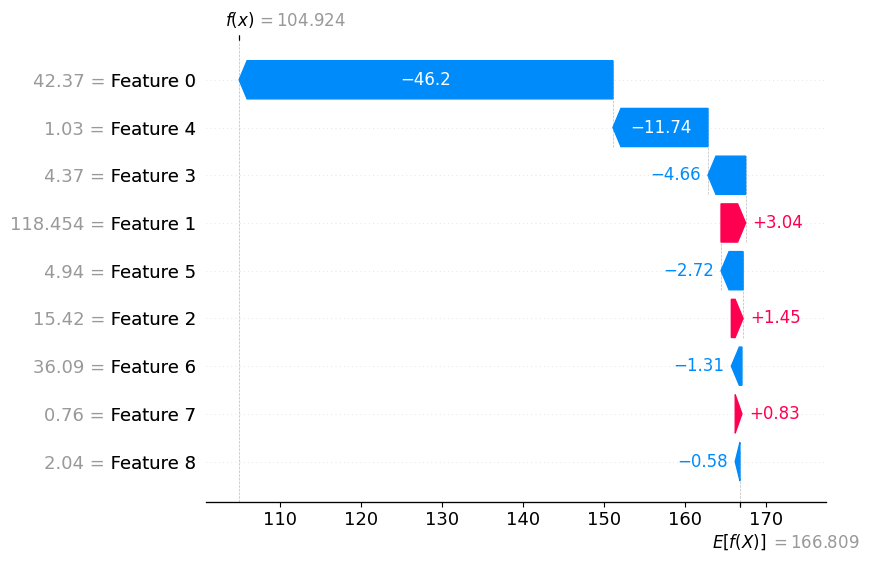

In [ ]:
# Select a single instance
instance = X_test[0].reshape(1, -1)

# Get SHAP values for the instance
shap_values_instance = explainer(instance)

# Plot individual feature contributions
shap.waterfall_plot(shap_values_instance[0])


In [ ]:
pip install lime


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 4.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=1d95558de709089c52182396c4a9a4c4d4a11a8fda7fe48c19305abc269a4509
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime
